<h2 style='text-align: center;'> <font size=6> XAI Project </font> </h2>

<font size=5> **Libraries load** </font>

In [1]:
import pandas as pd
import numpy as np

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
pd.options.display.max_rows = None
pd.options.display.max_columns = None

In [3]:
from plotly.subplots import make_subplots
import plotly.express as ex
import plotly.graph_objs as go
import plotly.figure_factory as ff
import plotly.offline as pyo
pyo.init_notebook_mode()

In [4]:
import warnings
warnings.filterwarnings("ignore")

<font size=5> **Data Loading and Pre-processing** </font>

In [5]:
churn_df = pd.read_csv(r'C:\Users\Prasanna_G\OneDrive\MSBA\5. Sem02\DBA5102 Capstone\XAI_Project\Churn_Modelling.csv')
churn_df.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [6]:
churn_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


In [7]:
# Creating a new df with only relevant columns for analysis
df = churn_df.copy()
df = df.drop(['RowNumber','Surname'], axis=1)
df = df.set_index('CustomerId')

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 15634602 to 15628319
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CreditScore      10000 non-null  int64  
 1   Geography        10000 non-null  object 
 2   Gender           10000 non-null  object 
 3   Age              10000 non-null  int64  
 4   Tenure           10000 non-null  int64  
 5   Balance          10000 non-null  float64
 6   NumOfProducts    10000 non-null  int64  
 7   HasCrCard        10000 non-null  int64  
 8   IsActiveMember   10000 non-null  int64  
 9   EstimatedSalary  10000 non-null  float64
 10  Exited           10000 non-null  int64  
dtypes: float64(2), int64(7), object(2)
memory usage: 937.5+ KB


In [9]:
df.shape

(10000, 11)

In [10]:
df.describe()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,650.528800,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,96.653299,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,350.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,584.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,652.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,718.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,850.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


In [11]:
# Checking class imbalance
df['Exited'].value_counts()

0    7963
1    2037
Name: Exited, dtype: int64

In [12]:
# Checking null values
df.isnull().sum()

CreditScore        0
Geography          0
Gender             0
Age                0
Tenure             0
Balance            0
NumOfProducts      0
HasCrCard          0
IsActiveMember     0
EstimatedSalary    0
Exited             0
dtype: int64

In [13]:
# Checking unique values
df.nunique()

CreditScore         460
Geography             3
Gender                2
Age                  70
Tenure               11
Balance            6382
NumOfProducts         4
HasCrCard             2
IsActiveMember        2
EstimatedSalary    9999
Exited                2
dtype: int64

In [14]:
df.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
CustomerId,,,,,,,,,,,
15634602,619,France,Female,42,2,0.00,1,1,1,101348.88,1
15647311,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
15619304,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
15701354,699,France,Female,39,1,0.00,2,0,0,93826.63,0
15737888,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


Notes: No clarity on when the data was collected, i.e. any specific dates or across multiple time points

<font size=5> **Exploratory Data Analysis** </font>

<font size = 3> <bold> 1. Proportion of exited customers is roughly 1/5 and seem to be higher for 'Female'.<br> 2. Approx. 31.2% of customers are investment grade customers (basis credit scores of 700+), approx. 38.2% of customers are average customers (credit scores of 600 - 700) and approx. 30.7% of customers are non-investment grade customers (credit score of <600). <br> 3. The median customer age is 37 years and the age group follows roughly a normal distribution <br> 4. The mean tenor of customers with the bank is 5 years and approx. 46.9% of customers have been with the bank for 5 - 10 years <br> 5. The income distribution of customers in the bracket <50k, 50 - 100k, 100 - 150k, 150 - 200k is 24.5%, 25.4%, 25.6% and 24.6% respectively <br> 6. Proportion of exited customers seem evenly distributed across all credit score buckets <br> 7. Proportion of exited customers seem evenly distributed across customers who have or don't have credit cards <br> 8. While France has highest number of customer, higher attrition is witnessed in Germany possibly on account of service issues due to lower number of customers and consequently, lower branches / staff <br> <> Charts capturing above points follows: </bold> </font>

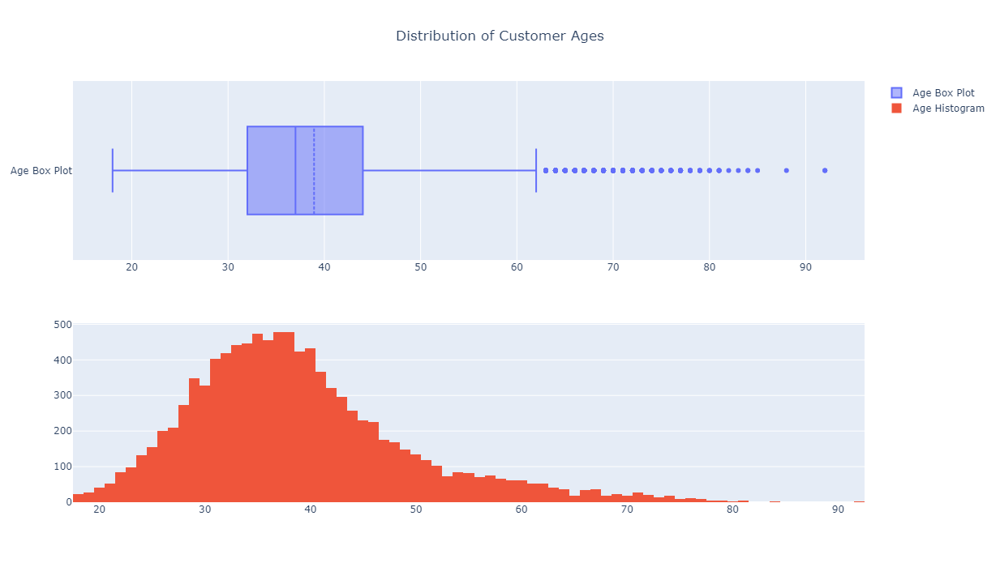

In [15]:
fig = make_subplots(rows=2, cols=1)

tr1=go.Box(x=df['Age'],name='Age Box Plot',boxmean=True)
tr2=go.Histogram(x=df['Age'],name='Age Histogram')

fig.add_trace(tr1,row=1,col=1)
fig.add_trace(tr2,row=2,col=1)

fig.update_layout(height=700, width=1200, title_text="Distribution of Customer Ages", title_x=0.5)
fig.show()

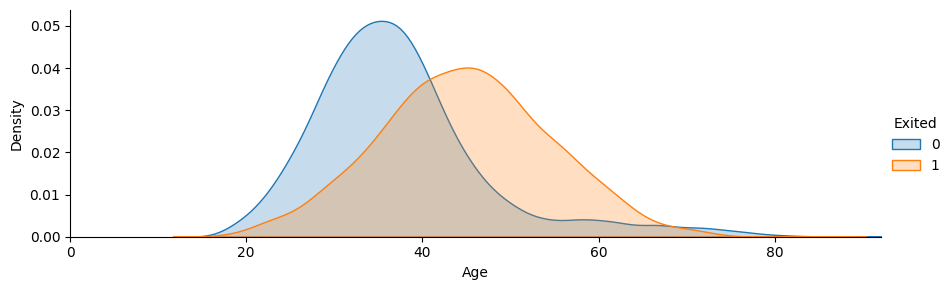

In [16]:
facet = sns.FacetGrid(df, hue="Exited",aspect=3)
facet.map(sns.kdeplot,"Age",shade= True)
facet.set(xlim=(0, df["Age"].max()))
facet.add_legend()

plt.show()

In [17]:
unique_values = df['NumOfProducts'].unique()
print("Unique values in NumOfProducts column:", unique_values)

Unique values in NumOfProducts column: [1 3 2 4]


In [18]:
unique_values = df['Geography'].unique()
print("Unique values in Geography column:", unique_values)

Unique values in Geography column: ['France' 'Spain' 'Germany']


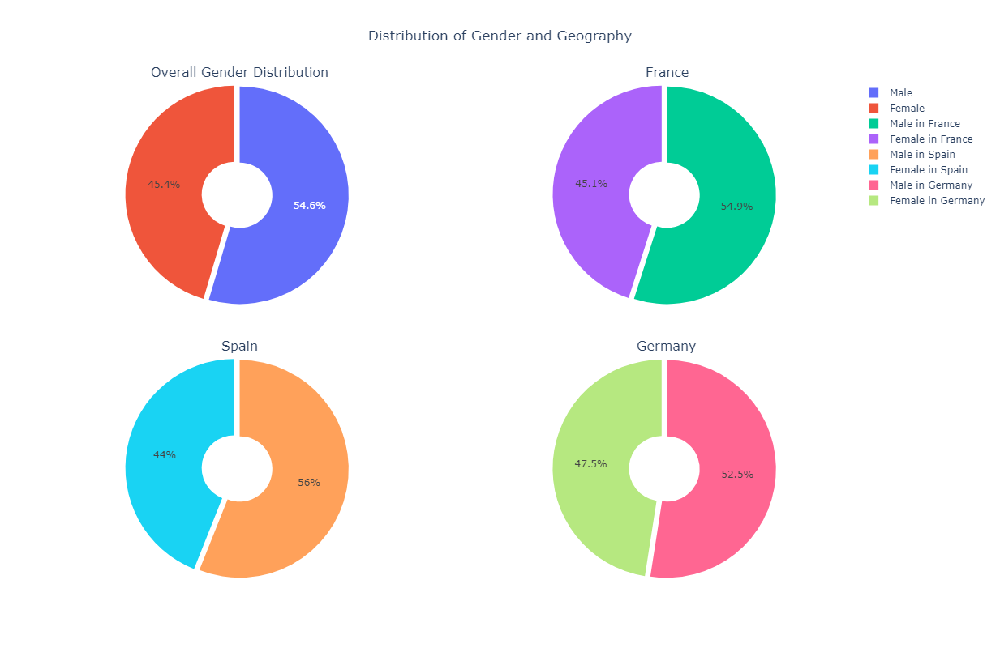

In [19]:
# Get unique geographies
unique_geographies = df['Geography'].unique()

# Create subplots
fig = make_subplots(
    rows=2, cols=2, subplot_titles=('Overall Gender Distribution', unique_geographies[0], unique_geographies[1], unique_geographies[2]),
    vertical_spacing=0.09,
    # specs=[[{"type": "pie", "rowspan": 2}, {"type": "pie"}],
    #        [None, {"type": "pie"}],
    #       ]
    specs=[[{"type": "pie"}, {"type": "pie"}],
           [{"type": "pie"}, {"type": "pie"}],
          ]
)

# Overall Gender Distribution
fig.add_trace(
    go.Pie(values=df.Gender.value_counts().values, labels=['Male', 'Female'], hole=0.3, pull=[0, 0.05]),
    row=1, col=1
)

# Geography-wise Gender Distribution
for i, geography in enumerate(unique_geographies, start=1):
    # row = 1 if i < 3 else 2
    # col = i % 2 + 1

    row = 1 if i < 2 else 2
    col = i % 2 + 1

    
    fig.add_trace(
        go.Pie(
            labels=['Male in ' + geography, 'Female in ' + geography],
            values=df[df['Geography'] == geography].Gender.value_counts().values,
            pull=[0, 0.05],
            hole=0.3
        ),
        row=row, col=col
    )

# Update layout
fig.update_layout(
    height=800,
    showlegend=True,
    title_text="Distribution of Gender and Geography", title_x=0.5
)

# Show plot
fig.show()

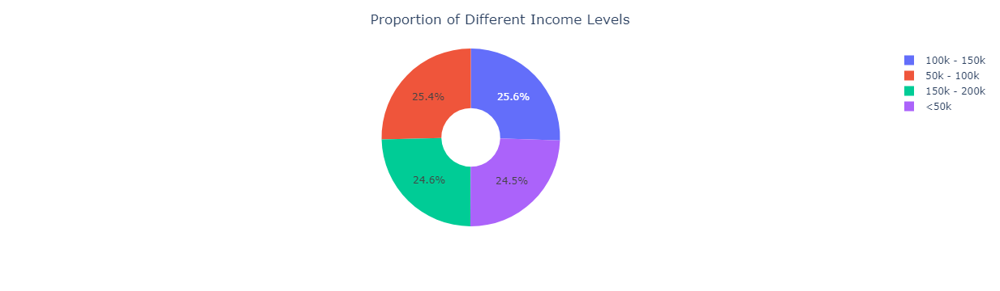

In [20]:
# Define the bins and labels for the SalaryBucket column
bins = [0, 50000, 100000, 150000, 200000]
labels = ['<50k', '50k - 100k', '100k - 150k', '150k - 200k']

# Create a new column with bucket labels based on EstimatedSalary column
df['SalaryBucket'] = pd.cut(df['EstimatedSalary'], bins=bins, labels=labels)

# Group data by SalaryBucket column
grouped_df = df.groupby('SalaryBucket', as_index=False).size()

# Plot pie chart with modified dataframe
fig = ex.pie(grouped_df, names='SalaryBucket', values='size', hole=0.33)

# Update layout
fig.update_layout(
    title_text='Proportion of Different Income Levels',
    title_x=0.5
)

# Show plot
fig.show()

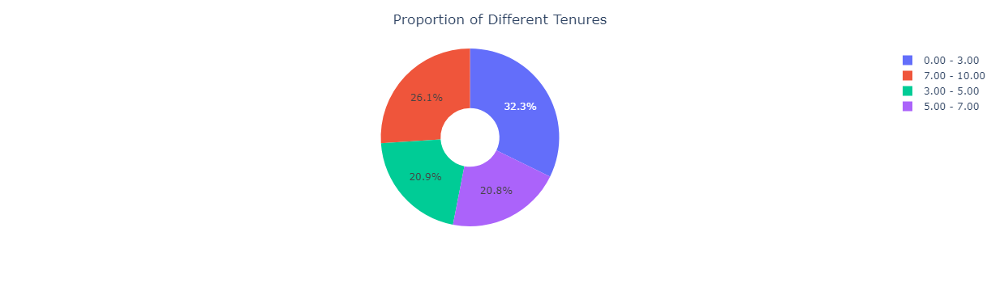

In [21]:
bins = [df['Tenure'].min(), *df['Tenure'].quantile([0.25, 0.5, 0.75]), df['Tenure'].max()]
labels = [f"{bins[i]:.2f} - {bins[i + 1]:.2f}" for i in range(len(bins) - 1)]

# Create a new column with bucket labels based on EstimatedSalary column
df['TenureBucket'] = pd.cut(df['Tenure'], bins=bins, labels=labels)

# Group data by SalaryBucket column
grouped_df = df.groupby('TenureBucket', as_index=False).size()

# Plot pie chart with modified dataframe
fig = ex.pie(grouped_df, names='TenureBucket', values='size', hole=0.33)

# Update layout
fig.update_layout(
    title_text='Proportion of Different Tenures',
    title_x=0.5
)

# Show plot
fig.show()

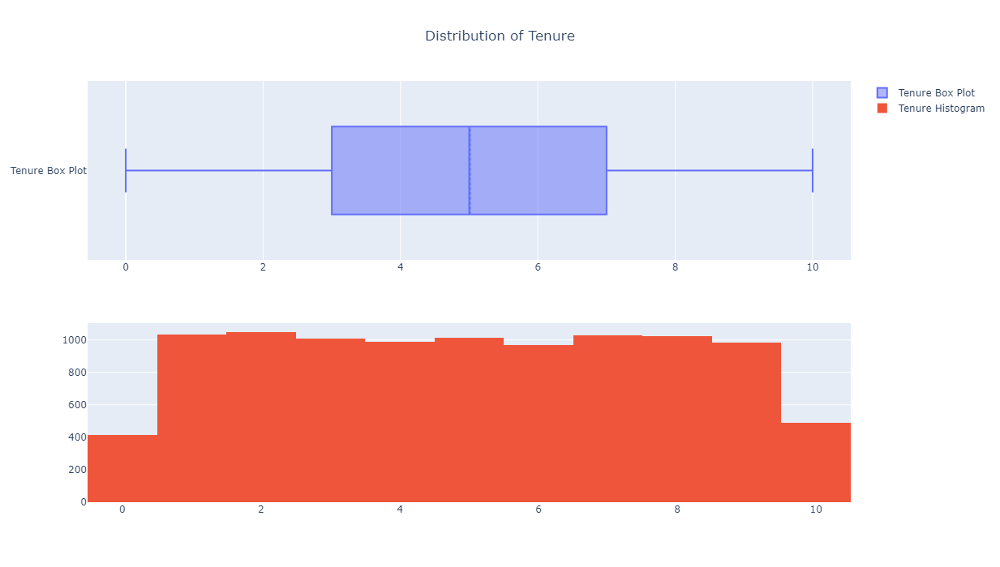

In [22]:
fig = make_subplots(rows=2, cols=1)

tr1=go.Box(x=df['Tenure'],name='Tenure Box Plot',boxmean=True)
tr2=go.Histogram(x=df['Tenure'],name='Tenure Histogram')

fig.add_trace(tr1,row=1,col=1)
fig.add_trace(tr2,row=2,col=1)

fig.update_layout(height=700, width=1200, title_text="Distribution of Tenure", title_x=0.5)
fig.show()

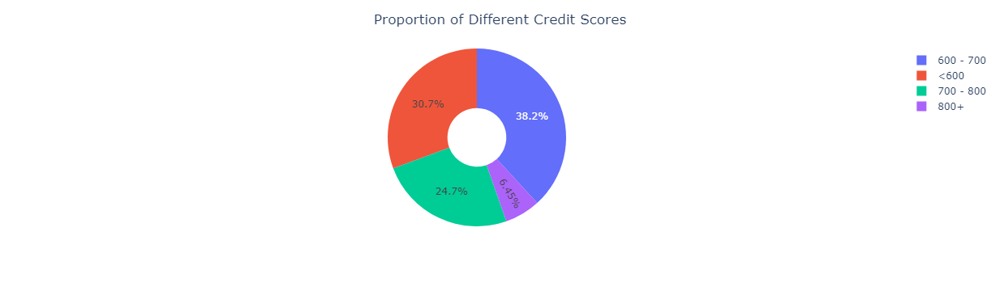

In [23]:
# Define the bins and labels for the SalaryBucket column
bins = [0, 600, 700, 800, 850]
labels = ['<600', '600 - 700', '700 - 800', '800+']

# Create a new column with bucket labels based on EstimatedSalary column
df['CSBucket'] = pd.cut(df['CreditScore'], bins=bins, labels=labels)

# Group data by SalaryBucket column
grouped_df = df.groupby('CSBucket', as_index=False).size()

# Plot pie chart with modified dataframe
fig = ex.pie(grouped_df, names='CSBucket', values='size', hole=0.33)

# Update layout
fig.update_layout(
    title_text='Proportion of Different Credit Scores',
    title_x=0.5
)

# Show plot
fig.show()

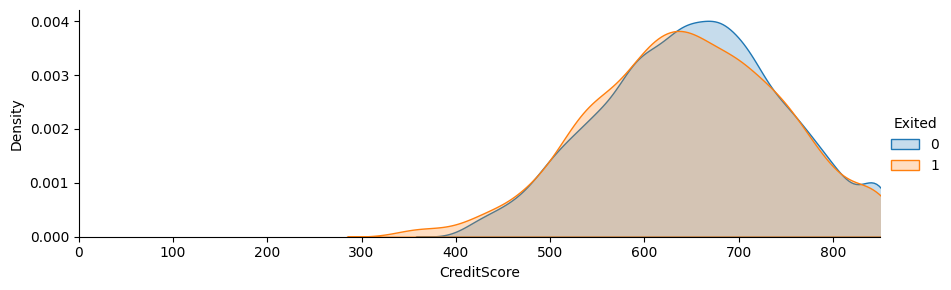

In [24]:
facet = sns.FacetGrid(df, hue="Exited",aspect=3)
facet.map(sns.kdeplot,"CreditScore",shade= True)
facet.set(xlim=(0, df["CreditScore"].max()))
facet.add_legend()

plt.show()

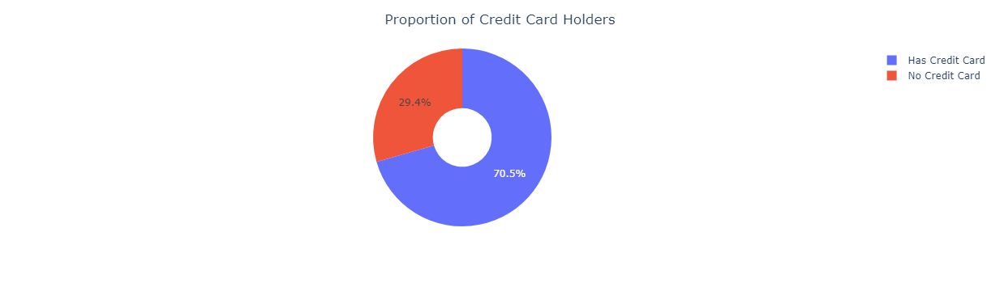

In [25]:
# Group data by HasCrCard column
grouped_df = df.groupby('HasCrCard', as_index=False).size()

# Rename HasCrCard values for better readability
grouped_df['HasCrCard'] = grouped_df['HasCrCard'].replace({0: 'No Credit Card', 1: 'Has Credit Card'})

# Plot pie chart with modified dataframe
fig = ex.pie(grouped_df, names='HasCrCard', values='size', hole=0.33)

# Update layout
fig.update_layout(
    title_text='Proportion of Credit Card Holders',
    title_x=0.5
)

# Show plot
fig.show()

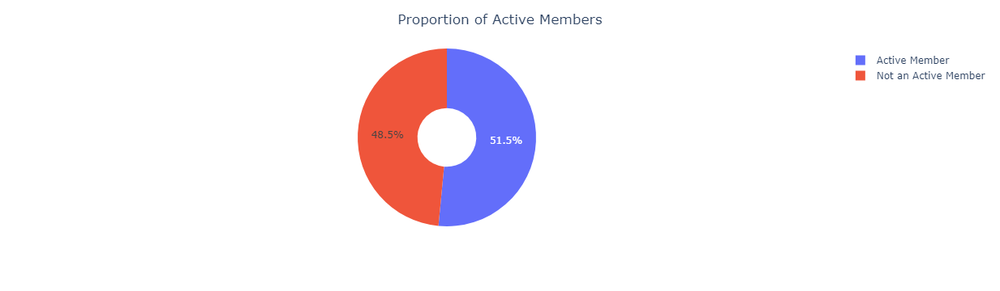

In [26]:
# Group data by IsActiveMember column
grouped_df = df.groupby('IsActiveMember', as_index=False).size()

# Rename HasCrCard values for better readability
grouped_df['IsActiveMember'] = grouped_df['IsActiveMember'].replace({0: 'Not an Active Member', 1: 'Active Member'})

# Plot pie chart with modified dataframe
fig = ex.pie(grouped_df, names='IsActiveMember', values='size', hole=0.33)

# Update layout
fig.update_layout(
    title_text='Proportion of Active Members',
    title_x=0.5
)

# Show plot
fig.show()

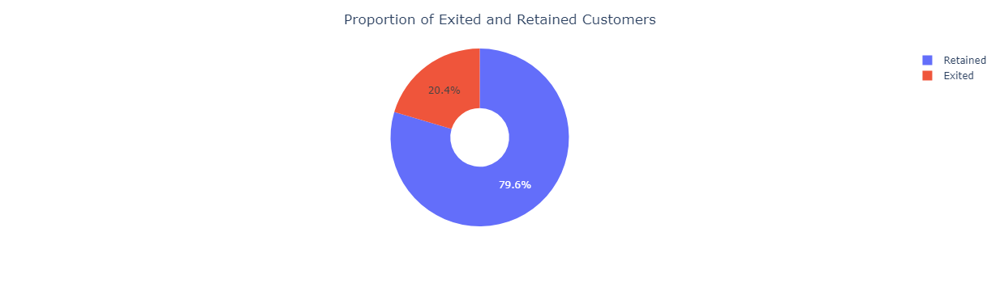

In [27]:
# Group data by Exited column
grouped_df = df.groupby('Exited', as_index=False).size()

# Rename HasCrCard values for better readability
grouped_df['Exited'] = grouped_df['Exited'].replace({0: 'Retained', 1: 'Exited'})

# Plot pie chart with modified dataframe
fig = ex.pie(grouped_df, names='Exited', values='size', hole=0.33)

# Update layout
fig.update_layout(
    title_text='Proportion of Exited and Retained Customers',
    title_x=0.5
)

# Show plot
fig.show()

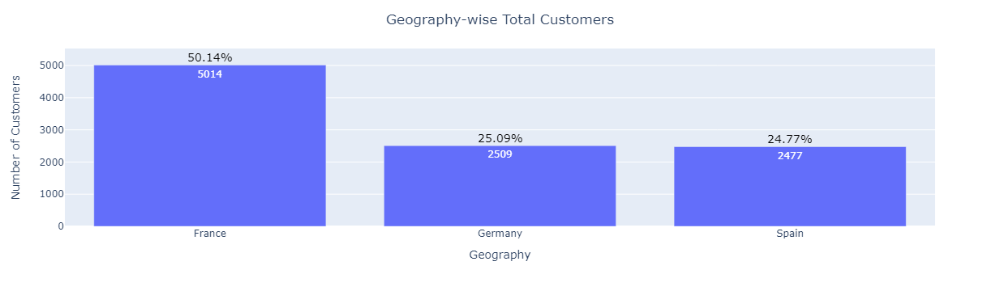

In [28]:
# Group data by Geography column
grouped_df = df.groupby('Geography', as_index=False).size()

# Calculate the percentage of customers for each geography
grouped_df['percentage'] = (grouped_df['size'] / df.shape[0]) * 100

# Plot bar chart with modified dataframe
fig = ex.bar(grouped_df, x='Geography', y='size', text='size')

# Update layout
fig.update_layout(
    title_text='Geography-wise Total Customers',
    title_x=0.5,  # Center the title
    xaxis_title="Geography",
    yaxis_title="Number of Customers"
)

# Add the percentages as annotations
for index, row in grouped_df.iterrows():
    fig.add_annotation(
        x=row['Geography'],
        y=row['size'],
        text=f"{row['percentage']:.2f}%",
        showarrow=False,
        font=dict(size=14, color='black'),
        yshift=10
    )

# Show plot
fig.show()

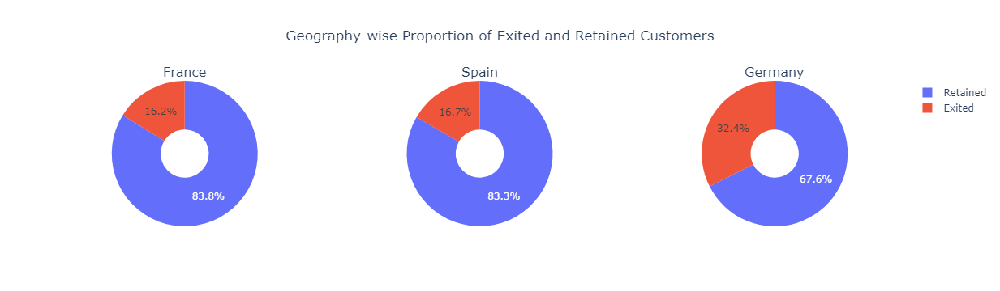

In [29]:
# Group data by Geography and Exited columns
grouped_df = df.groupby(['Geography', 'Exited'], as_index=False).size()

# Rename Exited values for better readability
grouped_df['Exited'] = grouped_df['Exited'].replace({0: 'Retained', 1: 'Exited'})

# Create subplots
fig = make_subplots(
    rows=1, cols=3, subplot_titles=df['Geography'].unique(),
    specs=[[{"type": "pie"}, {"type": "pie"}, {"type": "pie"}]]
)

# Geography-wise Exited and Retained Customers
for i, geography in enumerate(df['Geography'].unique(), start=1):
    geo_grouped_df = grouped_df[grouped_df['Geography'] == geography]
    fig.add_trace(
        go.Pie(
            labels=geo_grouped_df['Exited'],
            values=geo_grouped_df['size'],
            hole=0.33,
            name=geography
        ),
        row=1, col=i
    )

# Update layout
fig.update_layout(
    title_text='Geography-wise Proportion of Exited and Retained Customers',
    title_x=0.5
)

# Show plot
fig.show()

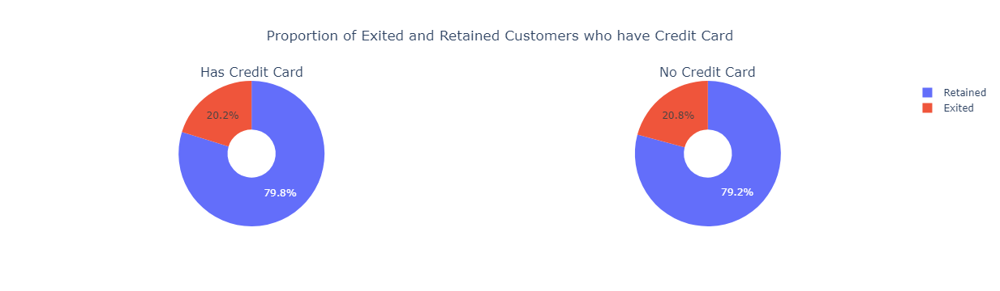

In [30]:
# Group data by HasCrCard and Exited columns
grouped_df = df.groupby(['HasCrCard', 'Exited'], as_index=False).size()

# Rename Exited values for better readability
grouped_df['Exited'] = grouped_df['Exited'].replace({0: 'Retained', 1: 'Exited'})

# Create subplots
fig = make_subplots(
    rows=1, cols=2, subplot_titles=['Has Credit Card', 'No Credit Card'],
    specs=[[{"type": "pie"}, {"type": "pie"}]]
)

# Credit card holders & non-holders - Exited and Retained Customers
for i, has_card in enumerate(df['HasCrCard'].unique(), start=1):
    card_grouped_df = grouped_df[grouped_df['HasCrCard'] == has_card]
    fig.add_trace(
        go.Pie(
            labels=card_grouped_df['Exited'],
            values=card_grouped_df['size'],
            hole=0.33,
            name=str(has_card)  # Convert the 'name' property value to a string
        ),
        row=1, col=i
    )

# Update layout
fig.update_layout(
    title_text='Proportion of Exited and Retained Customers who have Credit Card',
    title_x=0.5
)

# Show plot
fig.show()

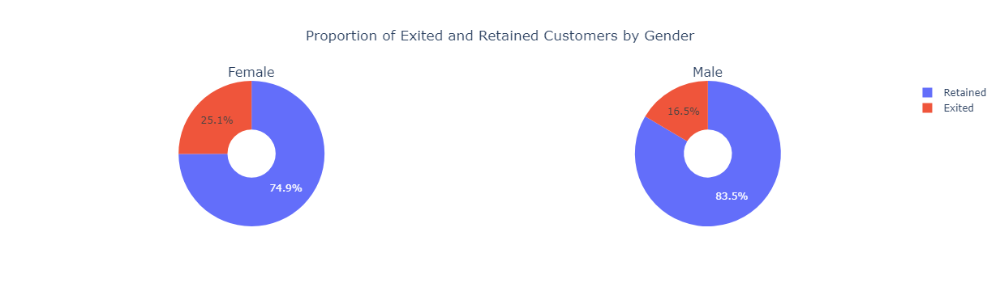

In [31]:
# Group data by Gender and Exited columns
grouped_df = df.groupby(['Gender', 'Exited'], as_index=False).size()

# Rename Exited values for better readability
grouped_df['Exited'] = grouped_df['Exited'].replace({0: 'Retained', 1: 'Exited'})

# Create subplots
fig = make_subplots(
    rows=1, cols=2, subplot_titles=['Female', 'Male'],
    specs=[[{"type": "pie"}, {"type": "pie"}]]
)

# Gender-wise Exited and Retained Customers
for i, gender in enumerate(df['Gender'].unique(), start=1):
    gender_grouped_df = grouped_df[grouped_df['Gender'] == gender]
    fig.add_trace(
        go.Pie(
            labels=gender_grouped_df['Exited'],
            values=gender_grouped_df['size'],
            hole=0.33,
            name=gender
        ),
        row=1, col=i
    )

# Update layout
fig.update_layout(
    title_text='Proportion of Exited and Retained Customers by Gender',
    title_x=0.5
)

# Show plot
fig.show()

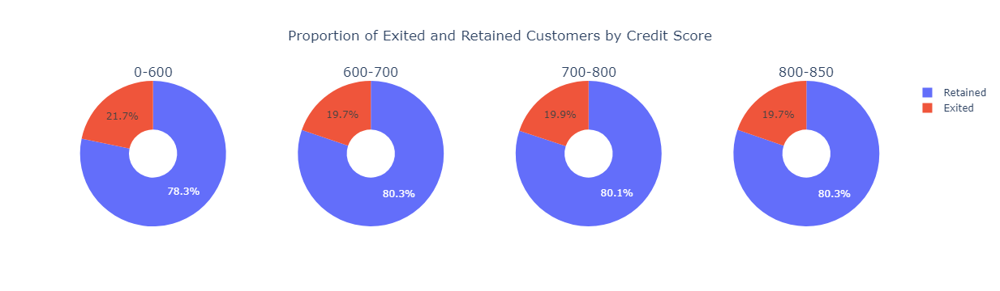

In [32]:
# Define the bins and create a new column for CreditScoreBin
bins = [0, 600, 700, 800, 850]
labels = ['0-600', '600-700', '700-800', '800-850']
df['CreditScoreBin'] = pd.cut(df['CreditScore'], bins=bins, labels=labels)

# Group data by CreditScoreBin and Exited columns
grouped_df = df.groupby(['CreditScoreBin', 'Exited'], as_index=False).size()

# Rename Exited values for better readability
grouped_df['Exited'] = grouped_df['Exited'].replace({0: 'Retained', 1: 'Exited'})

# Create subplots
fig = make_subplots(
    rows=1, cols=4, subplot_titles=labels,
    specs=[[{"type": "pie"}] * 4]
)

# CreditScoreBin-wise Exited and Retained Customers
for i, score_bin in enumerate(labels, start=1):
    bin_grouped_df = grouped_df[grouped_df['CreditScoreBin'] == score_bin]
    fig.add_trace(
        go.Pie(
            labels=bin_grouped_df['Exited'],
            values=bin_grouped_df['size'],
            hole=0.33,
            name=str(score_bin)
        ),
        row=1, col=i
    )

# Update layout
fig.update_layout(
    title_text='Proportion of Exited and Retained Customers by Credit Score',
    title_x=0.5
)

# Show plot
fig.show()

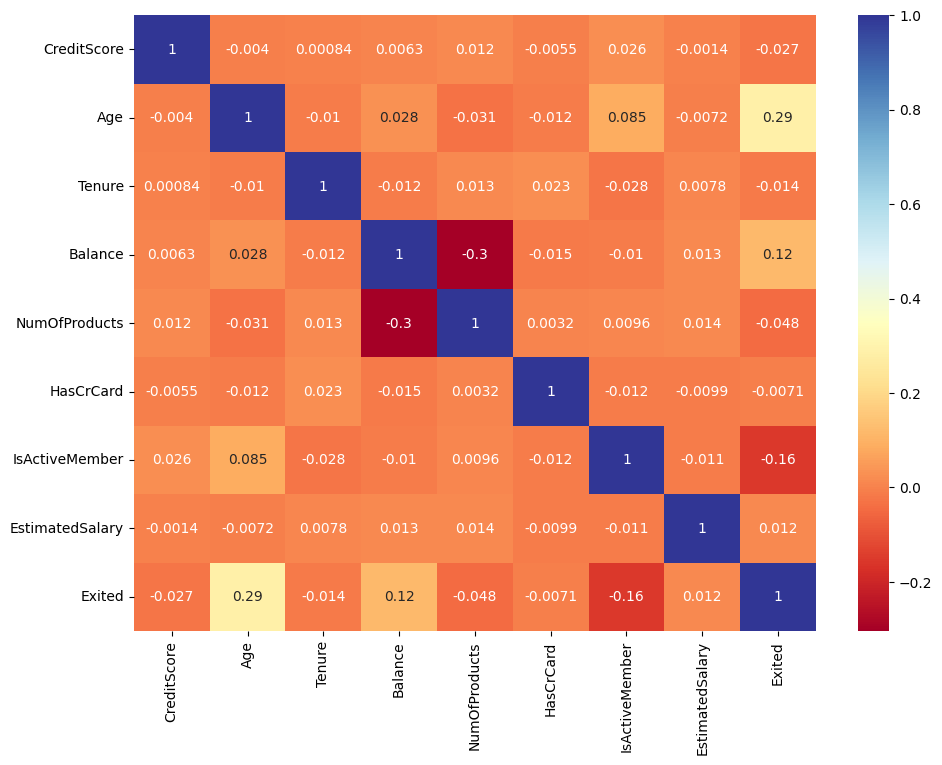

In [33]:
plt.subplots(figsize=(11,8))
sns.heatmap(df.corr(), annot=True, cmap="RdYlBu")
plt.show()

<font size=5> **Data Pre-processing** </font>

In [34]:
df = churn_df.copy()
df = df.drop(['RowNumber','Surname'], axis=1)
df = df.set_index('CustomerId')

In [35]:
from sklearn.preprocessing import OneHotEncoder

# Replace 0 values with -1 in 'IsActiveMember' and 'HasCrCard' for negative relationship with Exited
df['IsActiveMember'] = df['IsActiveMember'].replace({0: -1})
df['HasCrCard'] = df['HasCrCard'].replace({0: -1})

In [36]:
df['BalanceSalaryRatio'] = df['Balance']/df['EstimatedSalary']
df['CreditScoreGivenAge'] = df['CreditScore'] / (df['Age'])
df['NumProductsSalaryRatio'] = df['NumOfProducts']/df['EstimatedSalary']

In [37]:
df.isnull().sum()

CreditScore               0
Geography                 0
Gender                    0
Age                       0
Tenure                    0
Balance                   0
NumOfProducts             0
HasCrCard                 0
IsActiveMember            0
EstimatedSalary           0
Exited                    0
BalanceSalaryRatio        0
CreditScoreGivenAge       0
NumProductsSalaryRatio    0
dtype: int64

In [38]:
df.describe()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,BalanceSalaryRatio,CreditScoreGivenAge,NumProductsSalaryRatio
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,650.528800,38.921800,5.012800,76485.889288,1.530200,0.411000,0.030200,100090.239881,0.203700,3.878703,17.874340,0.000074
std,96.653299,10.487806,2.892174,62397.405202,0.581654,0.911681,0.999594,57510.492818,0.402769,108.337260,5.376363,0.000995
min,350.000000,18.000000,0.000000,0.000000,1.000000,-1.000000,-1.000000,11.580000,0.000000,0.000000,4.857143,0.000005
25%,584.000000,32.000000,3.000000,0.000000,1.000000,-1.000000,-1.000000,51002.110000,0.000000,0.000000,14.088889,0.000010
50%,652.000000,37.000000,5.000000,97198.540000,1.000000,1.000000,1.000000,100193.915000,0.000000,0.747002,17.285714,0.000015
75%,718.000000,44.000000,7.000000,127644.240000,2.000000,1.000000,1.000000,149388.247500,0.000000,1.514022,20.961538,0.000031
max,850.000000,92.000000,10.000000,250898.090000,4.000000,1.000000,1.000000,199992.480000,1.000000,10614.655440,46.888889,0.086356


In [39]:
# Find the rows with NaN or infinite values in the 'CreditScoreGivenAge' column
mask = np.isnan(df['CreditScoreGivenAge']) | np.isinf(df['CreditScoreGivenAge'])
rows_with_nan_or_inf = df[mask]

# Display the rows with NaN or infinite values
print(rows_with_nan_or_inf)

Empty DataFrame
Columns: [CreditScore, Geography, Gender, Age, Tenure, Balance, NumOfProducts, HasCrCard, IsActiveMember, EstimatedSalary, Exited, BalanceSalaryRatio, CreditScoreGivenAge, NumProductsSalaryRatio]
Index: []


In [40]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

continuous_vars = ['CreditScore', 'Age', 'Tenure', 'Balance','NumOfProducts', 'EstimatedSalary', 'BalanceSalaryRatio',
                   'CreditScoreGivenAge', 'NumProductsSalaryRatio']
X_continuous = df[continuous_vars]
scaler = StandardScaler()
X_continuous_scaled = scaler.fit_transform(X_continuous)

df[continuous_vars] = X_continuous_scaled
df.head()

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,BalanceSalaryRatio,CreditScoreGivenAge,NumProductsSalaryRatio
CustomerId,,,,,,,,,,,,,,
15634602,-0.326221,France,Female,0.293517,-1.041760,-1.225848,-0.911583,1,1,0.021886,1,-0.035804,-0.583369,-0.064008
15647311,-0.440036,Spain,Female,0.198164,-1.387538,0.117350,-0.911583,-1,1,0.216534,0,-0.028930,-0.566410,-0.064993
15619304,-1.536794,France,Female,0.293517,1.032908,1.333053,2.527057,1,-1,0.240687,1,-0.022868,-1.101536,-0.047466
15701354,0.501521,France,Female,0.007457,-1.387538,-1.225848,0.807737,-1,-1,-0.108918,0,-0.035804,0.009066,-0.052505
15737888,2.063884,Spain,Female,0.388871,-1.041760,0.785728,-0.911583,1,1,-0.365276,0,-0.021154,0.352133,-0.061217


In [41]:
# One-hot encoding for categorical variables
categorical_columns = ['Geography', 'Gender']

# Perform one-hot encoding with drop_first=True
dfohe = pd.get_dummies(df, columns=categorical_columns, drop_first=True)

In [42]:
dfohe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 15634602 to 15628319
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   CreditScore             10000 non-null  float64
 1   Age                     10000 non-null  float64
 2   Tenure                  10000 non-null  float64
 3   Balance                 10000 non-null  float64
 4   NumOfProducts           10000 non-null  float64
 5   HasCrCard               10000 non-null  int64  
 6   IsActiveMember          10000 non-null  int64  
 7   EstimatedSalary         10000 non-null  float64
 8   Exited                  10000 non-null  int64  
 9   BalanceSalaryRatio      10000 non-null  float64
 10  CreditScoreGivenAge     10000 non-null  float64
 11  NumProductsSalaryRatio  10000 non-null  float64
 12  Geography_Germany       10000 non-null  uint8  
 13  Geography_Spain         10000 non-null  uint8  
 14  Gender_Male             1000

In [43]:
dfohe = dfohe.reindex(columns=['CreditScore', 'Geography_Germany', 'Geography_Spain', 'Gender_Male', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard', 'IsActiveMember', 'EstimatedSalary', 'Exited', 'BalanceSalaryRatio', 'CreditScoreGivenAge', 'NumProductsSalaryRatio'])
dfohe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 15634602 to 15628319
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   CreditScore             10000 non-null  float64
 1   Geography_Germany       10000 non-null  uint8  
 2   Geography_Spain         10000 non-null  uint8  
 3   Gender_Male             10000 non-null  uint8  
 4   Age                     10000 non-null  float64
 5   Tenure                  10000 non-null  float64
 6   Balance                 10000 non-null  float64
 7   NumOfProducts           10000 non-null  float64
 8   HasCrCard               10000 non-null  int64  
 9   IsActiveMember          10000 non-null  int64  
 10  EstimatedSalary         10000 non-null  float64
 11  Exited                  10000 non-null  int64  
 12  BalanceSalaryRatio      10000 non-null  float64
 13  CreditScoreGivenAge     10000 non-null  float64
 14  NumProductsSalaryRatio  1000

<font size=5> **Train-Test Split and SMOTE** </font>

In [44]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

# Define features and target
X = dfohe.drop('Exited', axis=1)
y = dfohe['Exited']

# Perform stratified train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE to the training set
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

<font size=5> **Modelling** </font>

<table>
    <tr>
        <td>Model</td>
        <td>Recall</td>
        <td>FN</td>
        <td>Accuracy</td>
        <td>F1</td>
        <td>FP</td>
    </tr>
    <tr>
        <td>Logistic</td>
        <td>0.70</td>
        <td>123</td>
        <td>0.71</td>
        <td>0.49</td>
        <td>460</td>
    </tr>
    <tr>
        <td>RF</td>
        <td>0.68</td>
        <td>132</td>
        <td>0.81</td>
        <td>0.60</td>
        <td>242</td>
    </tr>
    <tr>
        <td>GB</td>
        <td>0.66</td>
        <td>139</td>
        <td>0.83</td>
        <td>0.61</td>
        <td>203</td>
    </tr>
    <tr>
        <td>SVM</td>
        <td>0.62</td>
        <td>155</td>
        <td>0.79</td>
        <td>0.54</td>
        <td>270</td>
    </tr>
    <tr>
        <td>XGB</td>
        <td>0.61</td>
        <td>157</td>
        <td>0.84</td>
        <td>0.61</td>
        <td>165</td>
    </tr>
</table>

<font size=5> - **Logistic Regression** </font>

In [45]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Train the logistic regression model with non-default hyperparameters
log = LogisticRegression(C=100, max_iter=250, tol=1e-05, random_state=42)
log.fit(X_train_smote, y_train_smote)

# Obtain predictions for the train data
y_train_pred = log.predict(X_train_smote)

In [46]:
# Obtain predictions for the test data
y_test_pred = log.predict(X_test)

In [47]:
# Print classification report for the train data
print("Classification report for the train data:")
print(classification_report(y_train_smote, y_train_pred))

Classification report for the train data:
              precision    recall  f1-score   support

           0       0.73      0.71      0.72      6370
           1       0.71      0.74      0.73      6370

    accuracy                           0.72     12740
   macro avg       0.72      0.72      0.72     12740
weighted avg       0.72      0.72      0.72     12740



In [48]:
# Print classification report for the test data
print("Classification report for the test data:")
print(classification_report(y_test, y_test_pred))

Classification report for the test data:
              precision    recall  f1-score   support

           0       0.90      0.71      0.80      1593
           1       0.38      0.70      0.49       407

    accuracy                           0.71      2000
   macro avg       0.64      0.70      0.64      2000
weighted avg       0.80      0.71      0.73      2000



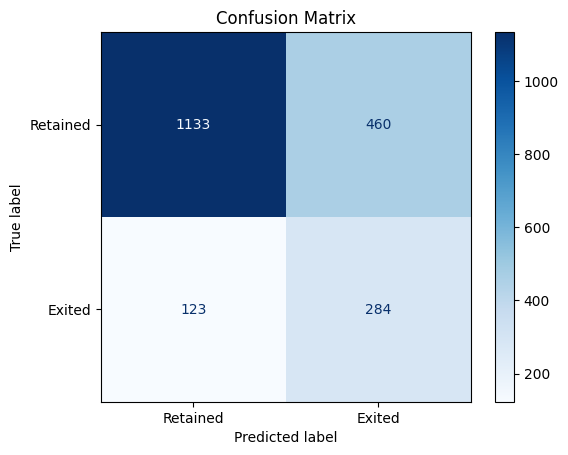

In [49]:
# Calculate confusion matrix
cm = confusion_matrix(y_test, y_test_pred)

# Display the confusion matrix
display_labels = ['Retained', 'Exited']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=display_labels)
disp.plot(cmap='Blues')
plt.grid(False)
plt.title("Confusion Matrix")
plt.show()

In [50]:
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score

# # Calculate scores for the train data
# train_precision = precision_score(y_train_smote, y_train_pred)
# train_recall = recall_score(y_train_smote, y_train_pred)
# train_accuracy = accuracy_score(y_train_smote, y_train_pred)
# train_f1 = f1_score(y_train_smote, y_train_pred)
# # Print scores for the train data
# print("Train data scores:")
# print(f"Precision: {train_precision:.4f}")
# print(f"Recall: {train_recall:.4f}")
# print(f"Accuracy: {train_accuracy:.4f}")
# print(f"F1 Score: {train_f1:.4f}")

# Calculate scores for the test data
test_precision = precision_score(y_test, y_test_pred)
test_recall = recall_score(y_test, y_test_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_f1 = f1_score(y_test, y_test_pred)

# Print scores for the test data
print("Test data scores:")
print(f"Precision: {test_precision:.4f}")
print(f"Recall: {test_recall:.4f}")
print(f"Accuracy: {test_accuracy:.4f}")
print(f"F1 Score: {test_f1:.4f}")

Test data scores:
Precision: 0.3817
Recall: 0.6978
Accuracy: 0.7085
F1 Score: 0.4935


<font size=5> - **SVM with RBF Kernel** </font>

In [51]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Train the SVM with RBF kernel
SVM_RBF = SVC(C=100, gamma=0.1, kernel='rbf', probability=True, random_state=42)
SVM_RBF.fit(X_train_smote, y_train_smote)

# Predictions for train and test data
y_train_pred = SVM_RBF.predict(X_train_smote)

In [52]:
y_test_pred = SVM_RBF.predict(X_test)

In [53]:
# Classification reports
print("Train data classification report:")
print(classification_report(y_train_smote, y_train_pred))

Train data classification report:
              precision    recall  f1-score   support

           0       0.95      0.91      0.93      6370
           1       0.92      0.95      0.93      6370

    accuracy                           0.93     12740
   macro avg       0.93      0.93      0.93     12740
weighted avg       0.93      0.93      0.93     12740



In [54]:
print("Test data classification report:")
print(classification_report(y_test, y_test_pred))

Test data classification report:
              precision    recall  f1-score   support

           0       0.90      0.83      0.86      1593
           1       0.48      0.62      0.54       407

    accuracy                           0.79      2000
   macro avg       0.69      0.72      0.70      2000
weighted avg       0.81      0.79      0.80      2000



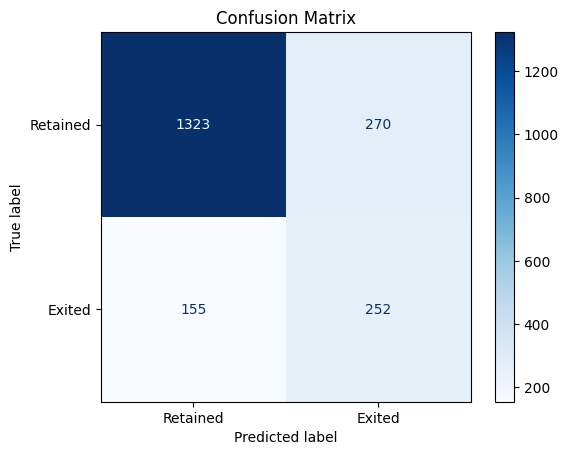

In [55]:
# Confusion matrix and display
cm_test = confusion_matrix(y_test, y_test_pred)

display_labels = ['Retained', 'Exited']
disp_test = ConfusionMatrixDisplay(confusion_matrix=cm_test, display_labels=display_labels)
disp_test.plot(cmap='Blues')
plt.grid(False)
plt.title("Confusion Matrix")
plt.show()

In [56]:
# # Calculate scores for the train data
# train_precision = precision_score(y_train_smote, y_train_pred)
# train_recall = recall_score(y_train_smote, y_train_pred)
# train_accuracy = accuracy_score(y_train_smote, y_train_pred)
# train_f1 = f1_score(y_train_smote, y_train_pred)
# # Print scores for the train data
# print("Train data scores:")
# print(f"Precision: {train_precision:.4f}")
# print(f"Recall: {train_recall:.4f}")
# print(f"Accuracy: {train_accuracy:.4f}")
# print(f"F1 Score: {train_f1:.4f}")

# Calculate scores for the test data
test_precision = precision_score(y_test, y_test_pred)
test_recall = recall_score(y_test, y_test_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_f1 = f1_score(y_test, y_test_pred)

# Print scores for the test data
print("Test data scores:")
print(f"Precision: {test_precision:.4f}")
print(f"Recall: {test_recall:.4f}")
print(f"Accuracy: {test_accuracy:.4f}")
print(f"F1 Score: {test_f1:.4f}")

Test data scores:
Precision: 0.4828
Recall: 0.6192
Accuracy: 0.7875
F1 Score: 0.5425


<font size=5> - **Random Forest** </font>

In [57]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Train the Random Forest classifier
RF = RandomForestClassifier(max_depth=8, max_features=6, min_samples_split=3, n_estimators=50, random_state=42)
RF.fit(X_train_smote, y_train_smote)

# Predictions for train and test data
y_train_pred = RF.predict(X_train_smote)

In [58]:
y_test_pred = RF.predict(X_test)

In [59]:
# Classification reports
print("Train data classification report:")
print(classification_report(y_train_smote, y_train_pred))

Train data classification report:
              precision    recall  f1-score   support

           0       0.85      0.87      0.86      6370
           1       0.87      0.85      0.86      6370

    accuracy                           0.86     12740
   macro avg       0.86      0.86      0.86     12740
weighted avg       0.86      0.86      0.86     12740



In [60]:
print("Test data classification report:")
print(classification_report(y_test, y_test_pred))

Test data classification report:
              precision    recall  f1-score   support

           0       0.91      0.85      0.88      1593
           1       0.53      0.68      0.60       407

    accuracy                           0.81      2000
   macro avg       0.72      0.76      0.74      2000
weighted avg       0.83      0.81      0.82      2000



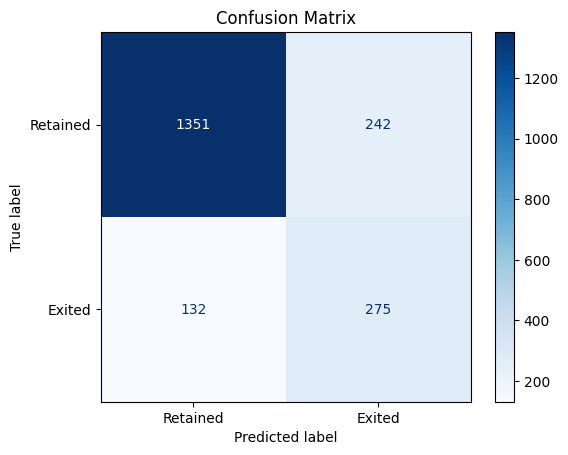

In [61]:
# Confusion matrix and display
cm_test = confusion_matrix(y_test, y_test_pred)

display_labels = ['Retained', 'Exited']
disp_test = ConfusionMatrixDisplay(confusion_matrix=cm_test, display_labels=display_labels)
disp_test.plot(cmap='Blues')
plt.grid(False)
plt.title("Confusion Matrix")
plt.show()

In [62]:
# # Calculate scores for the train data
# train_precision = precision_score(y_train_smote, y_train_pred)
# train_recall = recall_score(y_train_smote, y_train_pred)
# train_accuracy = accuracy_score(y_train_smote, y_train_pred)
# train_f1 = f1_score(y_train_smote, y_train_pred)

# # Print scores for the train data
# print("Train data scores:")
# print(f"Precision: {train_precision:.4f}")
# print(f"Recall: {train_recall:.4f}")
# print(f"Accuracy: {train_accuracy:.4f}")
# print(f"F1 Score: {train_f1:.4f}")

# Calculate scores for the test data
test_precision = precision_score(y_test, y_test_pred)
test_recall = recall_score(y_test, y_test_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)
test_f1 = f1_score(y_test, y_test_pred)

# Print scores for the test data
print("Test data scores:")
print(f"Precision: {test_precision:.4f}")
print(f"Recall: {test_recall:.4f}")
print(f"Accuracy: {test_accuracy:.4f}")
print(f"F1 Score: {test_f1:.4f}")

Test data scores:
Precision: 0.5319
Recall: 0.6757
Accuracy: 0.8130
F1 Score: 0.5952


<font size=5> - **XG Boost** </font>

In [63]:
import xgboost as xgb
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, precision_score, recall_score, f1_score

# Fit Extreme Gradient Boost Classifier
XGB = xgb.XGBClassifier(gamma=0.01, max_depth=7, min_child_weight=5, n_estimators=20, random_state=42, silent=True)
XGB.fit(X_train_smote, y_train_smote)

[16:11:46] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-0fc7796c793e6356f-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "silent" } are not used.



XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.01, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=5, missing=nan, monotone_constraints=None,
              n_estimators=20, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=42, ...)

In [64]:
# Train data classification report
y_train_pred = XGB.predict(X_train_smote)
print("Train data classification report:")
print(classification_report(y_train_smote, y_train_pred))

Train data classification report:
              precision    recall  f1-score   support

           0       0.90      0.93      0.91      6370
           1       0.93      0.90      0.91      6370

    accuracy                           0.91     12740
   macro avg       0.91      0.91      0.91     12740
weighted avg       0.91      0.91      0.91     12740



In [65]:
# Test data classification report
y_test_pred = XGB.predict(X_test)
print("Test data classification report:")
print(classification_report(y_test, y_test_pred))

Test data classification report:
              precision    recall  f1-score   support

           0       0.90      0.90      0.90      1593
           1       0.60      0.61      0.61       407

    accuracy                           0.84      2000
   macro avg       0.75      0.76      0.75      2000
weighted avg       0.84      0.84      0.84      2000



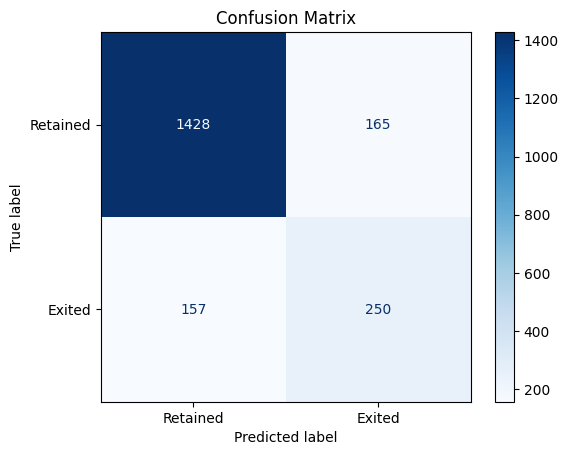

In [66]:
# Test data confusion matrix
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Retained', 'Exited'])
disp.plot(cmap='Blues')
plt.grid(False)
plt.title("Confusion Matrix")
plt.show()

In [67]:
# Calculate precision, recall, accuracy, and F1 score for train and test data
# print("Train data metrics:")
# print(f"Precision: {precision_score(y_train_smote, y_train_pred)}")
# print(f"Recall: {recall_score(y_train_smote, y_train_pred)}")
# print(f"Accuracy: {accuracy_score(y_train_smote, y_train_pred)}")
# print(f"F1 score: {f1_score(y_train_smote, y_train_pred)}")

print("Test data metrics:")
print(f"Precision: {precision_score(y_test, y_test_pred):.4f}")
print(f"Recall: {recall_score(y_test, y_test_pred):.4f}")
print(f"Accuracy: {accuracy_score(y_test, y_test_pred):.4}")
print(f"F1 score: {f1_score(y_test, y_test_pred):.4f}")

Test data metrics:
Precision: 0.6024
Recall: 0.6143
Accuracy: 0.839
F1 score: 0.6083


<font size=5> - **Gradient Boosting** </font>

In [68]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, precision_score, recall_score, f1_score

# Fit Gradient Boosting Classifier
GB = GradientBoostingClassifier(learning_rate=0.1, max_depth=3, n_estimators=100, random_state=42)
GB.fit(X_train_smote, y_train_smote)

GradientBoostingClassifier(random_state=42)

In [69]:
# Train data classification report
y_train_pred = GB.predict(X_train_smote)
print("Train data classification report:")
print(classification_report(y_train_smote, y_train_pred))

Train data classification report:
              precision    recall  f1-score   support

           0       0.86      0.88      0.87      6370
           1       0.88      0.86      0.87      6370

    accuracy                           0.87     12740
   macro avg       0.87      0.87      0.87     12740
weighted avg       0.87      0.87      0.87     12740



In [70]:
# Test data classification report
y_test_pred = GB.predict(X_test)
print("Test data classification report:")
print(classification_report(y_test, y_test_pred))

Test data classification report:
              precision    recall  f1-score   support

           0       0.91      0.87      0.89      1593
           1       0.57      0.66      0.61       407

    accuracy                           0.83      2000
   macro avg       0.74      0.77      0.75      2000
weighted avg       0.84      0.83      0.83      2000



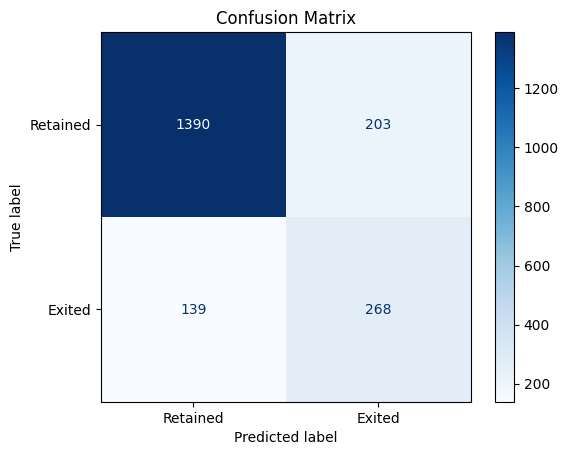

In [71]:
# Test data confusion matrix
cm = confusion_matrix(y_test, y_test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Retained', 'Exited'])
disp.plot(cmap='Blues')
plt.grid(False)
plt.title("Confusion Matrix")
plt.show()

In [72]:
# Calculate precision, recall, accuracy, and F1 score for train and test data
# print("Train data metrics:")
# print(f"Precision: {precision_score(y_train_smote, y_train_pred)}")
# print(f"Recall: {recall_score(y_train_smote, y_train_pred)}")
# print(f"Accuracy: {accuracy_score(y_train_smote, y_train_pred)}")
# print(f"F1 score: {f1_score(y_train_smote, y_train_pred)}")

print("Test data metrics:")
print(f"Precision: {precision_score(y_test, y_test_pred):.4f}")
print(f"Recall: {recall_score(y_test, y_test_pred):.4}")
print(f"Accuracy: {accuracy_score(y_test, y_test_pred):.4}")
print(f"F1 score: {f1_score(y_test, y_test_pred):.4}")

Test data metrics:
Precision: 0.5690
Recall: 0.6585
Accuracy: 0.829
F1 score: 0.6105


<font size=5> **ROC Curve** </font>

In [73]:
from sklearn.metrics import roc_auc_score, roc_curve

def get_auc_scores(y_true, y_pred, y_prob):
    auc = roc_auc_score(y_true, y_pred)
    fpr, tpr, _ = roc_curve(y_true, y_prob)
    return auc, fpr, tpr

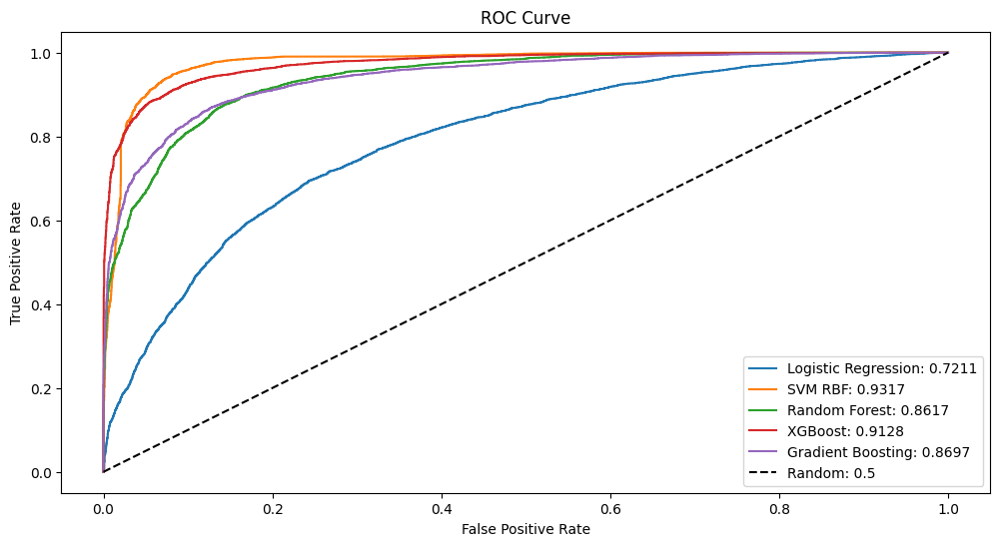

In [74]:
y = y_train_smote
X = X_train_smote

auc_log, fpr_log, tpr_log = get_auc_scores(y, log.predict(X), log.predict_proba(X)[:, 1])
auc_SVM_RBF, fpr_SVM_RBF, tpr_SVM_RBF = get_auc_scores(y, SVM_RBF.predict(X), SVM_RBF.predict_proba(X)[:, 1])
auc_RF, fpr_RF, tpr_RF = get_auc_scores(y, RF.predict(X), RF.predict_proba(X)[:, 1])
auc_XGB, fpr_XGB, tpr_XGB = get_auc_scores(y, XGB.predict(X), XGB.predict_proba(X)[:, 1])
auc_GB, fpr_GB, tpr_GB = get_auc_scores(y, GB.predict(X), GB.predict_proba(X)[:, 1])

plt.figure(figsize=(12, 6), linewidth=1)
plt.plot(fpr_log, tpr_log, label='Logistic Regression: ' + str(round(auc_log, 4)))
plt.plot(fpr_SVM_RBF, tpr_SVM_RBF, label='SVM RBF: ' + str(round(auc_SVM_RBF, 4)))
plt.plot(fpr_RF, tpr_RF, label='Random Forest: ' + str(round(auc_RF, 4)))
plt.plot(fpr_XGB, tpr_XGB, label='XGBoost: ' + str(round(auc_XGB, 4)))
plt.plot(fpr_GB, tpr_GB, label='Gradient Boosting: ' + str(round(auc_GB, 4)))
plt.plot([0, 1], [0, 1], 'k--', label='Random: 0.5')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='best')
plt.show()

<font size=4> ** For a comparison of the best model for the specific use case, we need a model which has the highest recall of the 1's (Exited) and lowest False Negative (Predicted Retained but True Exited). The model which meets this criteria is Logistic Regression which has a recall of 0.70 and an accuracy of 0.71** </font>

<font size=4> ** However, while recall is indeed important, logistic regression performs poorly on the number of false positives. There is a cost associated with reaching out to customers belonging to the False Positives which also need to be curtailed. Hence, we opt for Random Forest Model which has Recall close to that of logistic regression (0.68 RF vs. 0.70 Log) but with a significantly lower false positives (242 RF vs. 460 Log)  ** </font>

<font size=5> **Explainable AI** </font>

<font size=5> - **SHAP** </font>

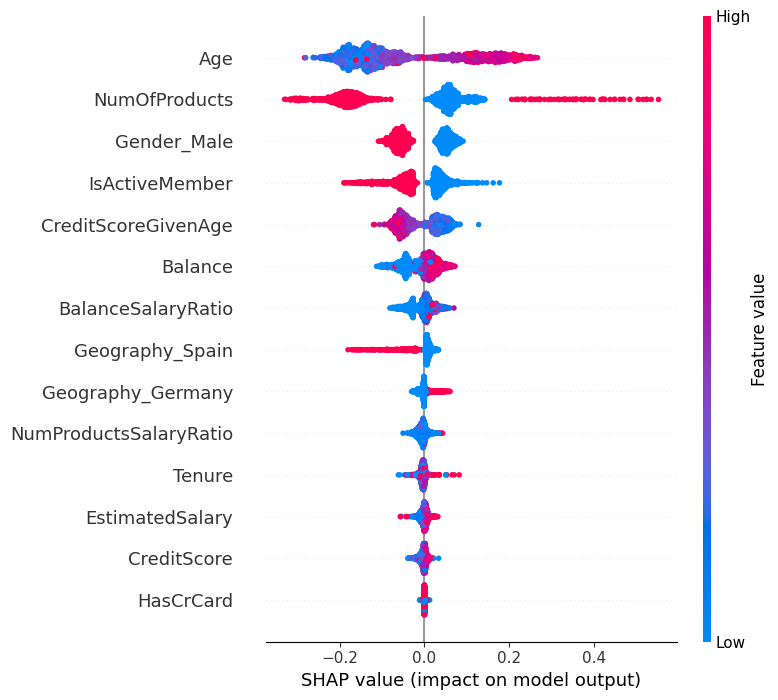

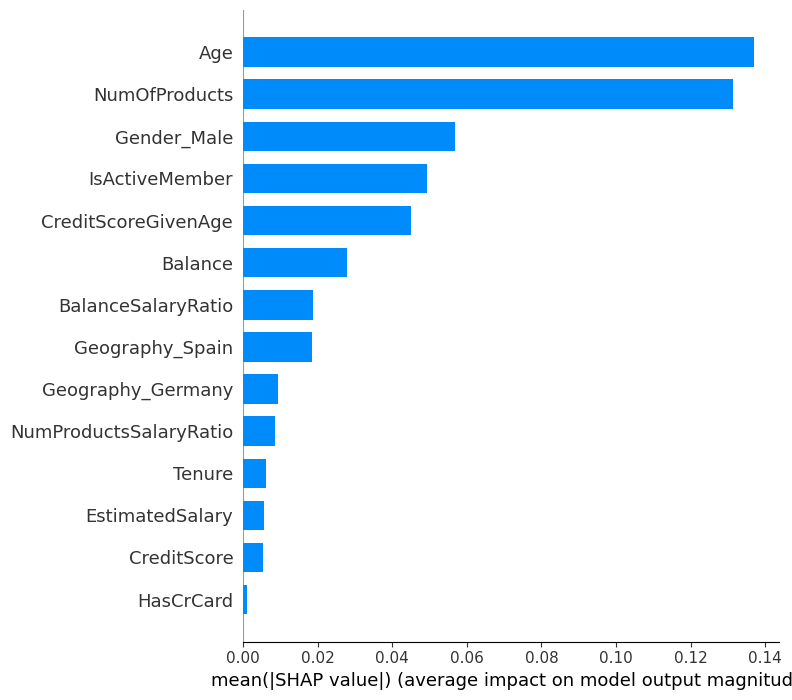

In [75]:
import shap

explainer = shap.TreeExplainer(RF)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values[1], X_test)
shap.summary_plot(shap_values[1], X_test, plot_type="bar")

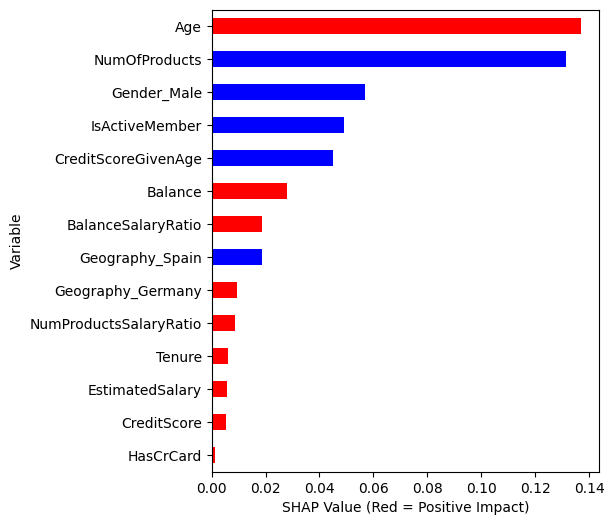

In [76]:
def ABS_SHAP(df_shap, df):
    shap_v = pd.DataFrame(df_shap)
    feature_list = df.columns
    shap_v.columns = feature_list
    df_v = df.copy().reset_index(drop=True)
    
    corr_list = list()
    for i in feature_list:
        b = np.corrcoef(shap_v[i], df_v[i])[1][0]
        corr_list.append(b)
    corr_df = pd.concat([pd.Series(feature_list), pd.Series(corr_list)], axis=1).fillna(0)
    corr_df.columns  = ['Variable', 'Corr']
    corr_df['Sign'] = np.where(corr_df['Corr'] > 0, 'red', 'blue')
    
    shap_abs = np.abs(shap_v)
    k = pd.DataFrame(shap_abs.mean()).reset_index()
    k.columns = ['Variable', 'SHAP_abs']
    k2 = k.merge(corr_df, left_on='Variable', right_on='Variable', how='inner')
    k2 = k2.sort_values(by='SHAP_abs', ascending=True)
    colorlist = k2['Sign']
    ax = k2.plot.barh(x='Variable', y='SHAP_abs', color=colorlist, figsize=(5, 6), legend=False)
    ax.set_xlabel("SHAP Value (Red = Positive Impact)")

ABS_SHAP(shap_values[1], X_test)

<font size=4> Based on the above results, the top 5 features which has higher impact on model's predictions are 'Age', 'NumOfProducts' and 'Gender_Male'. Red basrs indicate positive correlation and blue bars indicate negative correlation. This means the following: <br> 1. As age increases, there is a higher chance for the customer to exit, that is older customers are more likely to churn <br> 2. As number of products increase, the chance of customer exit decreases, that is customers with more products are less likely to churn <br> 3. Male customer has lower chance of exit as compared to Female <br> 4. Active members who have higher level of engagement are less likely to churn <br> 5. With increase in credit score, customers are less likely to exit possibly due to more product offerings from the bank <br> It may be noted that while age has the highest correlation, number of products has a bigger range of effect on predictions </font>

<font size=5> - **Permutation Feature Importance** </font>

Weight,Feature
0.0651 ± 0.0050,Age
0.0633 ± 0.0124,NumOfProducts
0.0130 ± 0.0073,IsActiveMember
0.0077 ± 0.0113,Gender_Male
0.0038 ± 0.0020,Geography_Germany
0.0037 ± 0.0085,Balance
0.0015 ± 0.0028,Tenure
0.0012 ± 0.0036,Geography_Spain
0.0003 ± 0.0034,CreditScore
-0.0004 ± 0.0010,HasCrCard


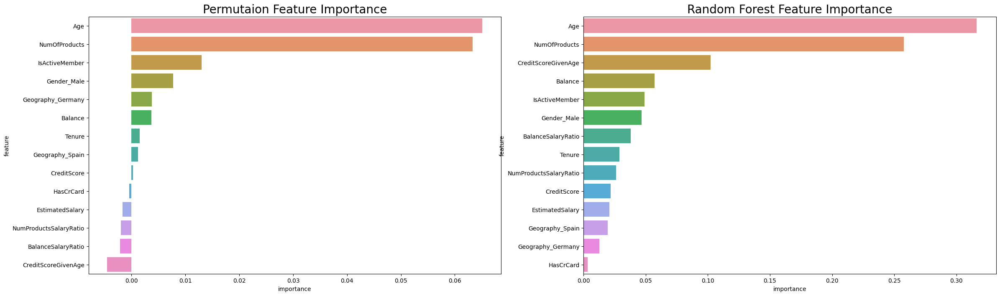

In [77]:
import eli5
from eli5.sklearn import PermutationImportance

base_features = ['CreditScore', 'Geography_Germany', 'Geography_Spain', 'Gender_Male', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard', 'IsActiveMember', 
                 'EstimatedSalary', 'BalanceSalaryRatio', 'CreditScoreGivenAge', 'NumProductsSalaryRatio']

perm = PermutationImportance(RF, random_state=42).fit(X_test, y_test)

# Store Permutaion feature importance details in the dataframe for further analysis
perm_df = pd.DataFrame()
perm_df["feature"] = base_features
perm_df["importance"] = perm.feature_importances_

# Store Randomforest feature importance details in the dataframe for further analysis
rf_feature_importance_df = pd.DataFrame()
rf_feature_importance_df["feature"] = base_features
rf_feature_importance_df["importance"] = RF.feature_importances_

# plot PFI chart
fig, axes = plt.subplots(1, 2, figsize=(28,8))
plt.rcParams.update({'font.size': 12})
#Permutation Feature Importance
perm_feature_importance_df  = perm_df.sort_values('importance', ascending=False).reset_index()
sns.barplot(x ='importance', y ='feature', data= perm_feature_importance_df[:20], ax=axes[0])
axes[0].set_title("Permutaion Feature Importance", fontsize=20)

#Random Forest Default Feature Importance
feature_importance_df  = rf_feature_importance_df.sort_values('importance', ascending=False).reset_index()
sns.barplot(x ='importance', y ='feature', data= feature_importance_df[:20], ax=axes[1])
axes[1].set_title("Random Forest Feature Importance", fontsize=20)

eli5.show_weights(perm, feature_names = X_test.columns.tolist())

<font size=5> - **Partial Dependency Plot** </font>

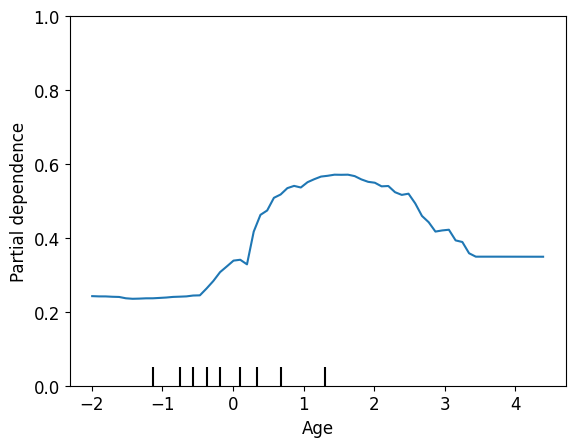

In [78]:
from matplotlib import pyplot as plt
from sklearn.inspection import PartialDependenceDisplay

feat_name = 'Age'
PartialDependenceDisplay.from_estimator(RF, X_test, [feat_name])
plt.ylim(0, 1)
plt.show()

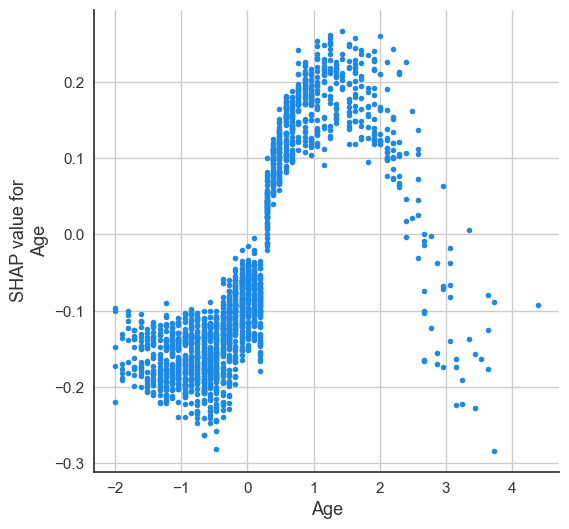

In [108]:
explainercat = shap.TreeExplainer(RF)
shap_values_rf_test = explainercat.shap_values(X_test)
fig, ax= plt.subplots(figsize=(6,6),dpi=100)
shp_plt = shap.dependence_plot('Age', shap_values_rf_test[1], X_test, ax=ax, interaction_index=None)

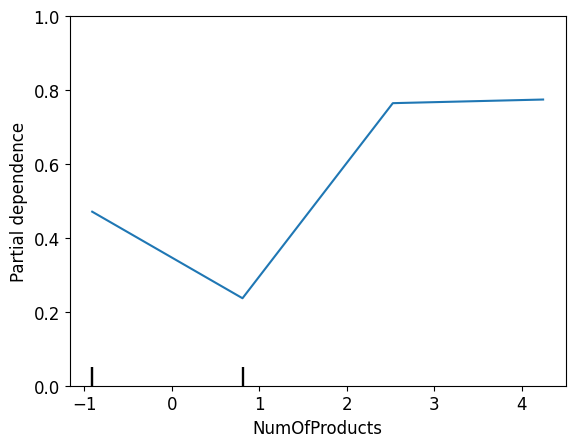

In [79]:
from matplotlib import pyplot as plt
from sklearn.inspection import PartialDependenceDisplay

feat_name = 'NumOfProducts'
PartialDependenceDisplay.from_estimator(RF, X_test, [feat_name])
plt.ylim(0, 1)
plt.show()

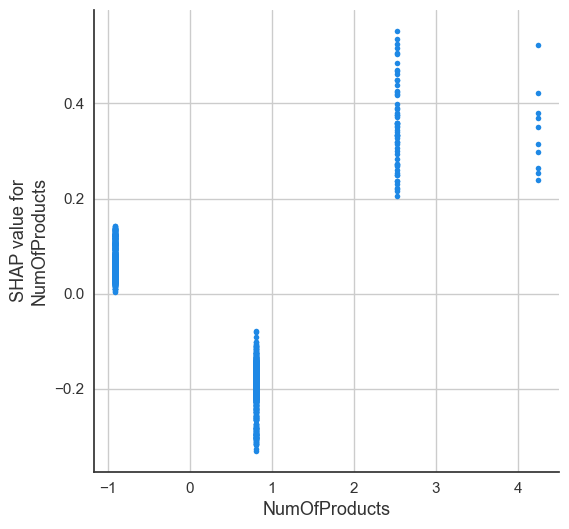

In [109]:
explainercat = shap.TreeExplainer(RF)
shap_values_rf_test = explainercat.shap_values(X_test)
fig, ax= plt.subplots(figsize=(6,6),dpi=100)
shp_plt = shap.dependence_plot('NumOfProducts', shap_values_rf_test[1], X_test, ax=ax, interaction_index=None)

<font size=5> - **Check for a sample record** </font>

In [80]:
def customer_exit_factors(model, customer_data):
    # Create object that can calculate shap values
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(customer_data)
    shap.initjs()
    return shap.force_plot(explainer.expected_value[1], shap_values[1], customer_data)

data_for_exploration = X_test.iloc[14]
customer_exit_factors(RF, data_for_exploration)

In [81]:
customer_id = X_test.index[14]
original_record = churn_df[churn_df['CustomerId'] == customer_id]
original_record

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
5622,5623,15766649,Vincent,670,France,Male,38,10,89416.99,1,0,0,144275.39,0


<font size=4> For the above record, it can be seen that Age of customer is 38 which is around median age (lower end of age group) and accordingy resulting in probability of exit to be lower <br> Similarly, customer being male results in higher likelihood of retention of customer <br> Number of Products is only 1 which indicates higher change of customer exit <br> The net impact is there is higher chance of customer being retained </font>

In [82]:
data_for_exploration = X_test.iloc[20]
customer_exit_factors(RF, data_for_exploration)

In [83]:
customer_id = X_test.index[20]
original_record = churn_df[churn_df['CustomerId'] == customer_id]
original_record

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
4799,4800,15656683,Johnson,551,France,Male,52,1,0.0,1,0,0,63584.55,1


<font size=4> For the above record, it can be seen that Age is higher at 52 which indicates higher chance of exit <br> Similarly, Number of Products is only 1 which indicates higher change of customer exit <br> Customer being male results in reducing the likelihood customer exit <br> The net impact is there is a higher chance of customer exit </font>

In [84]:
explainer = shap.TreeExplainer(RF)
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test)

<font size=5> - **Waterfall Model** </font>

In [85]:
# explainer = shap.Explainer(RF)
# shap_values = explainer(X_test)
# shap.plots._waterfall.waterfall_legacy(explainer.expected_value[1],shap_values[14].values[:,0],
#                                         feature_names=X_test.columns)

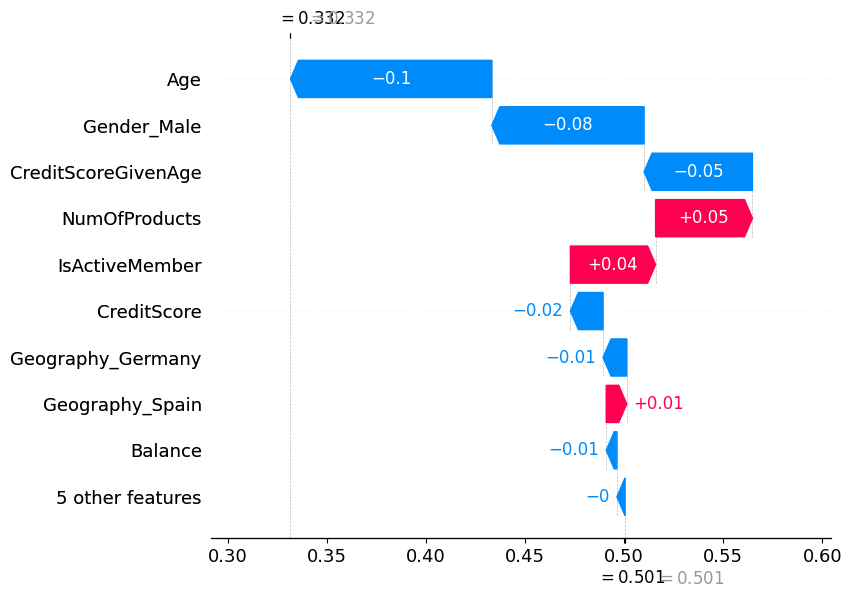

In [86]:
explainer = shap.Explainer(RF)
shap_values = explainer(X_test)
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[1],shap_values[14].values[:,1],
                                        feature_names=X_test.columns)

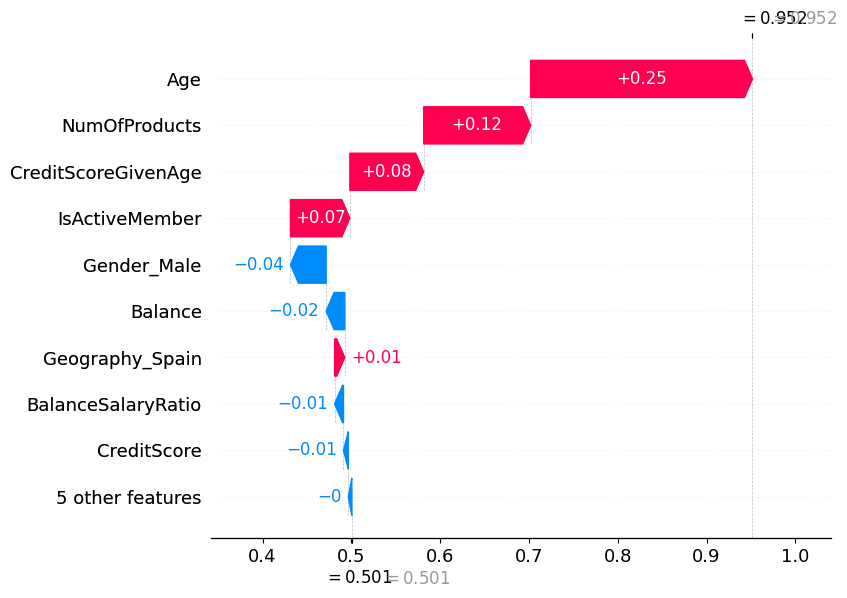

In [87]:
explainer = shap.Explainer(RF)
shap_values = explainer(X_test)
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[1],shap_values[20].values[:,1],
                                        feature_names=X_test.columns)

<font size=5> - **LIME** </font>

In [88]:
import lime
import lime.lime_tabular
import numpy as np

In [89]:
class_labels = RF.classes_

explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=X_train.columns,
    class_names=class_labels,  
    mode='classification'  
)

In [90]:
customer_id = X_test.index[14]
original_record = churn_df[churn_df['CustomerId'] == customer_id]
original_record

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
5622,5623,15766649,Vincent,670,France,Male,38,10,89416.99,1,0,0,144275.39,0


In [91]:
instance = X_test.iloc[14].values
num_features = 14
exp = explainer.explain_instance(instance, RF.predict_proba, num_features=num_features)

In [92]:
exp.show_in_notebook()

In [93]:
customer_id = X_test.index[20]
original_record = churn_df[churn_df['CustomerId'] == customer_id]
original_record

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
4799,4800,15656683,Johnson,551,France,Male,52,1,0.0,1,0,0,63584.55,1


In [94]:
instance = X_test.iloc[20].values
num_features = 14
exp = explainer.explain_instance(instance, RF.predict_proba, num_features=num_features)

In [95]:
exp.show_in_notebook()

<font size=5> - **Tree Representation** </font>

In [96]:
from sklearn import tree
idx = 14
sample = X_test.iloc[idx, :]

# Get the predicted class probabilities for the sample
probs = RF.predict_proba([sample])[0]

# Select the first decision tree from the list and plot it
tree_list = RF.estimators_
plt.figure(figsize=(16, 12), dpi=1200)
tree.plot_tree(
    tree_list[0],
    filled=True,
    feature_names=X.columns,
    class_names=["not_exited", "exited"],
    node_ids=True,
);

plt.title(f"Sample {idx} (predicted probabilities: not exited={probs[0]:.2f}, exited={probs[1]:.2f})")

plt.savefig('tree.png', bbox_inches='tight')

<font size=5> - **Pearson Ranking of Features** </font>

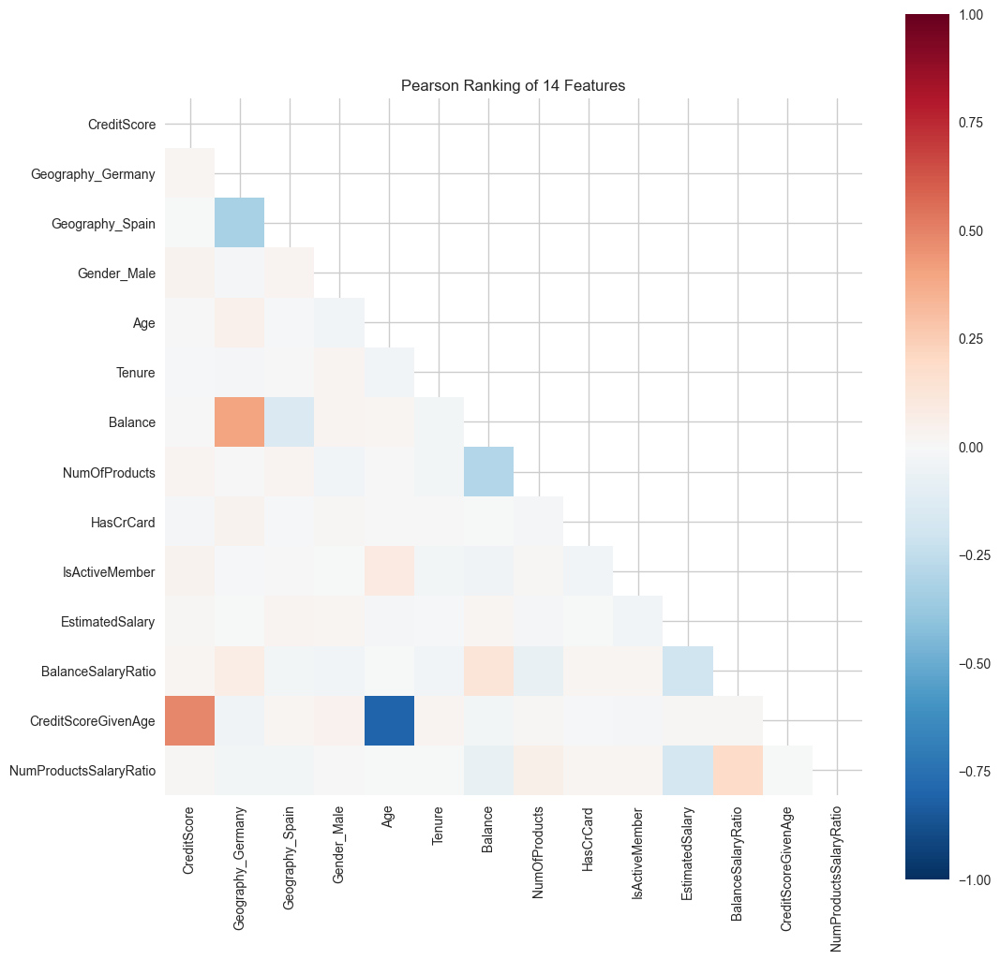

<Axes: title={'center': 'Pearson Ranking of 14 Features'}>

In [97]:
from yellowbrick.features import Rank2D

fig, ax = plt.subplots(1, figsize=(12, 12))
vzr = Rank2D(ax=ax)
vzr.fit(X_train_smote, y_train_smote)
vzr.transform(X_test)
sns.despine(left=True, bottom=True)
vzr.poof()

<font size=5> - **MLXTEND Visualization** </font>

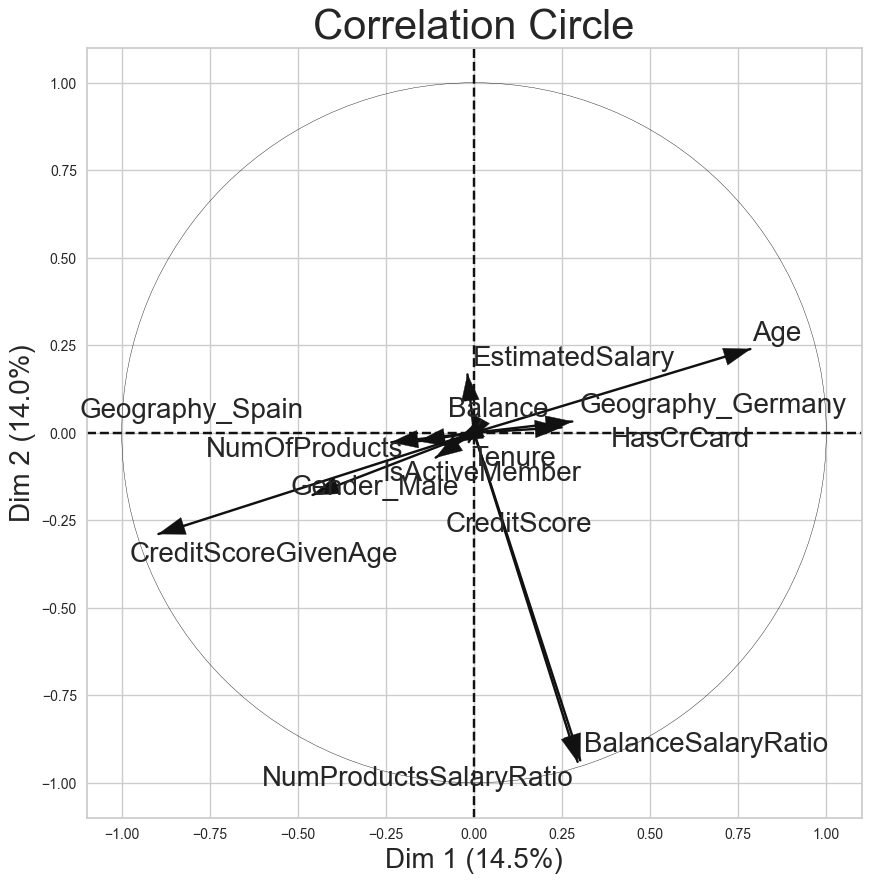

In [98]:
from mlxtend.plotting import plot_pca_correlation_graph

X_norm = X_train_smote / X_train_smote.std(axis=0)

feature_names = X_train_smote.columns.tolist()

figure, correlation_matrix = plot_pca_correlation_graph(X_norm, 
                                                        feature_names,
                                                        dimensions=(1, 2),
                                                        figure_axis_size=10)

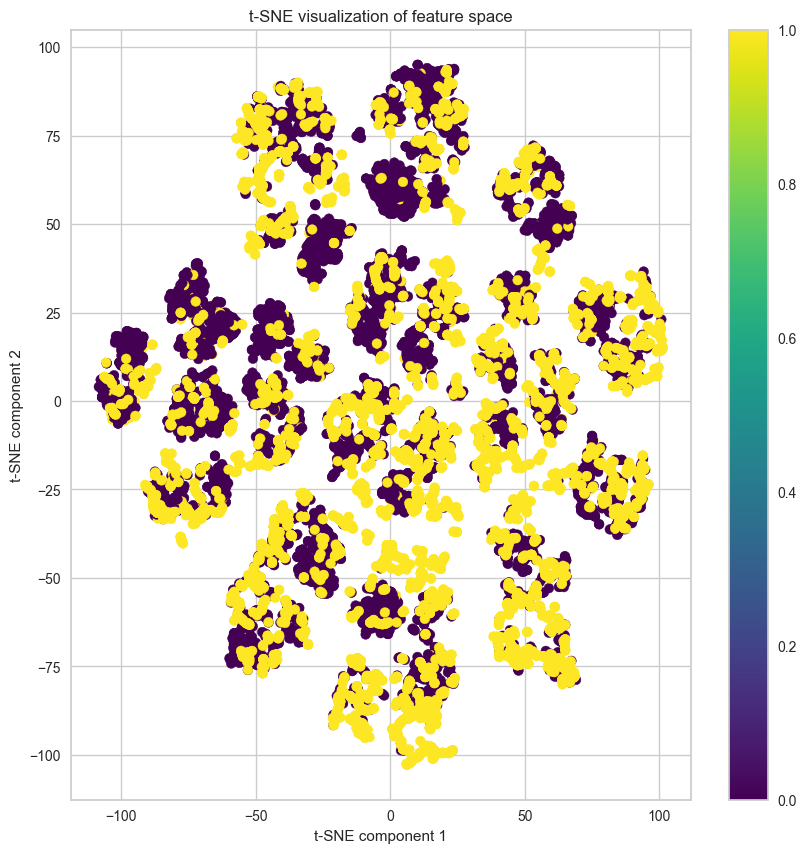

In [99]:
from sklearn.manifold import TSNE

X_embedded = TSNE(n_components=2, perplexity=30, random_state=42).fit_transform(X_norm)

# Plot the t-SNE visualization
plt.figure(figsize=(10, 10))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=y_train_smote, cmap='viridis')
plt.title('t-SNE visualization of feature space')
plt.xlabel('t-SNE component 1')
plt.ylabel('t-SNE component 2')
plt.colorbar()
plt.show()